### Packages Used

In [1]:
import plotly
from plotly.graph_objs import Scatter, Layout
import pandas as pd
import numpy as np
import locale
locale.setlocale(locale.LC_ALL, '')
from plotly.graph_objs import *
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('seaborn-whitegrid')

### Set plotly to offline; produce all plots in the notebook

In [2]:
plotly.offline.init_notebook_mode(connected=True)

### Import the best model's test set performance

Which does not contain independent variables.

In [3]:
# Import best notebook and narrow that information to only the best model
best_model_perf = pd.read_csv("C:\\Users\\Jeremy Diaz\\Documents\\earth-analytics\\tornadoesr\\Complete_Workflow\\28-2_test_perf.csv")

### Import the unprocessed data

To undo the data processing with the same values.

In [4]:
unproc_tor_df = pd.read_csv("C:\\Users\\Jeremy Diaz\\Documents\\earth-analytics\\tornadoesr\\data\\raw\\tor_data_with_interact_effects.csv")

Storing those values.

In [5]:
mean_lat = np.mean(unproc_tor_df['BEGIN_LAT'])
stand_dev_lat = np.std(unproc_tor_df['BEGIN_LAT'])

mean_lon = np.mean(unproc_tor_df['BEGIN_LON'])
stand_dev_lon = np.std(unproc_tor_df['BEGIN_LON'])

mean_log_dam = np.mean(np.log(unproc_tor_df['DAMAGE_PROPERTY'] + 1))
stand_dev_log_dam = np.std(np.log(unproc_tor_df['DAMAGE_PROPERTY'] + 1))

### Import the test set

To get location information.

In [6]:
test_set = pd.read_csv("C:\\Users\\Jeremy Diaz\\Documents\\earth-analytics\\tornadoesr\\data\\raw\\tor_test_set_no_zeros.csv")

Undo the processing.

In [7]:
test_set['natural_scale_true'] = np.exp((test_set['DAMAGE_PROPERTY'] * stand_dev_log_dam) + mean_log_dam) - 1

test_set['natural_scale_pred'] = np.exp((best_model_perf['predicted_values'] * stand_dev_log_dam) + mean_log_dam) - 1

test_set['natural_scale_resid'] = test_set['natural_scale_pred'] - test_set['natural_scale_true']

test_set['BEGIN_LAT'] = (test_set['BEGIN_LAT'] * stand_dev_lat) + mean_lat

test_set['BEGIN_LON'] = (test_set['BEGIN_LON'] * stand_dev_lon) + mean_lon

This will tell whether each prediction was an over- or underestimate, get the absolute difference between predicted and true values (in log-10 scale), then apply the corresponding sign for that difference (negative for underestimates and positive for overestimates).

In [8]:
sign_list = []

for i in range(len(test_set)):
    
    if test_set['natural_scale_resid'][i] > 0:
        sign_list.append(1)
        
    else:
        sign_list.append(-1)
    
test_set['natural_resid_sign'] = sign_list

test_set['log_10_abs_resid'] = np.log10(abs(test_set['natural_scale_resid']))

test_set['log_10_resid_direction'] = test_set['natural_resid_sign'] * test_set['log_10_abs_resid']

Getting a clean label for each point.

In [9]:
labels = []

for i in range(len(test_set['natural_scale_resid'])):
    
    intermediate = locale.format("%d", test_set["natural_scale_resid"][i], grouping = True)
    
    intermediate = "$" + intermediate
    
    labels.append(intermediate)

resid_str_list = np.repeat('Residual: ', len(test_set))

true_str_list = np.repeat('<br>True Damage: ', len(test_set))


labels_better = []

for i in range(len(test_set)):
    
    intermediate = locale.format("%d", test_set["natural_scale_true"][i], grouping = True)
    
    intermediate = "$" + intermediate
    
    intermediate = resid_str_list[i] + labels[i] + true_str_list[i] + intermediate
    
    labels_better.append(intermediate)

### Import U.S. cities data

In [10]:
cities_df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2014_us_cities.csv')

cities_df = cities_df[cities_df['pop'] > 100000]

Get some clean, useful labels for each city point

In [11]:
cities_df['pop'] = cities_df.apply(lambda x: "{:,}".format(x['pop']), axis=1)

city_labels = "Name: " + cities_df['name'] + "<br>Population: " + cities_df['pop']

# The Test Set Residual Map

This will produce the map, showing where and by how much the model was wrong. Dark blues imply strong overestimates, while dark reds imply strong underestimates. Lighter coolors indicate where the model did relatively well.

In [12]:
trace1 = {"lon": test_set["BEGIN_LON"],
          "lat":  test_set["BEGIN_LAT"],
          "name": "Residual",
          "text": labels_better,
          "marker": {"color": test_set["log_10_resid_direction"],
                     "colorscale": [[0.0, 'rgb(165,0,38)'],
                                         [0.1111111111111111, 'rgb(215,48,39)'],
                                         [0.2222222222222222, 'rgb(244,109,67)'],
                                         [0.3333333333333333, 'rgb(253,174,97)'],
                                         [0.4444444444444444, 'rgb(254,224,144)'],
                                         [0.5555555555555556, 'rgb(224,243,248)'],
                                         [0.6666666666666666, 'rgb(171,217,233)'],
                                         [0.7777777777777778, 'rgb(116,173,209)'],
                                         [0.8888888888888888, 'rgb(69,117,180)'],
                                         [1.0, 'rgb(49,54,149)']],
                     "size": 5.5,
                     "cmin": test_set['log_10_resid_direction'].min(),
                     "cmax": test_set['log_10_resid_direction'].min(),
                     "colorbar": dict(title = 'Direction and Magnitude<br>of Residual')},
          "type": "scattergeo", 
          "visible": True}

trace2 = {"lon": cities_df["lon"],
          "lat":  cities_df["lat"],
          "name": "City",
          "text": city_labels,
          "marker": {"size": 5,
                     "symbol": "star-open",
                     "color": "black"},
          "type": "scattergeo"}

data = Data([trace1, trace2])

layout = dict(geo = dict(scope = 'north america',
                         showland = True,
                         landcolor = "rgb(255, 255, 255)",
                         subunitcolor = "rgb(0, 0, 0)",
                         countrycolor = "rgb(0, 0, 0)",
                         showlakes = True,
                         showocean = True,
                         lakecolor = "rgb(247, 247, 247)",
                         oceancolor = "rgb(247, 247, 247)",
                         showsubunits = True,
                         showcountries = True,
                         resolution = 50,
                         lonaxis = dict(showgrid = True,
                                        gridwidth = 0.05,
                                        range= [-125.0, -70.0],
                                        dtick = 5),
                         lataxis = dict(showgrid = True,
                                        gridwidth = 0.05,
                                        range= [23.0, 50.0],
                                        dtick = 5)),
              title = 'Map of Test Set Residuals',
              showlegend = False)

fig1 = {'data':data,
       'layout':layout}

plotly.offline.iplot(fig1)

## How does the Model Fail?

#### Natural Scale Exploration

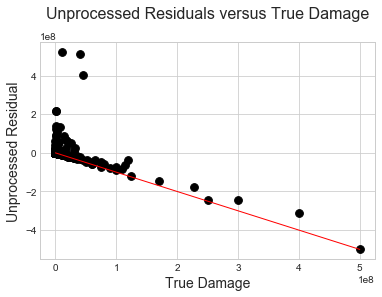

In [13]:
plt.scatter(test_set['natural_scale_true'],
            test_set['natural_scale_resid'],
            facecolor = 'k', s = 60)
plt.plot([0, 5e8], [0, -5e8], 'r', lw = 1)
plt.ylabel("Unprocessed Residual", size = 14)
plt.xlabel("True Damage", size = 14)
plt.title("Unprocessed Residuals versus True Damage\n", size = 16)

It appears, when the model underestimates by a large amount it's exclusively because it was a very damaging tornado.

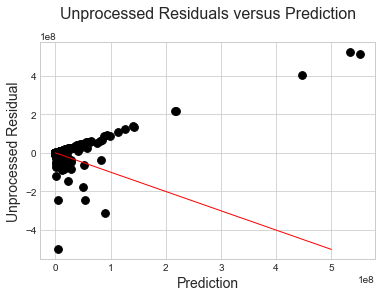

In [14]:
plt.scatter(test_set['natural_scale_pred'],
            test_set['natural_scale_resid'],
            facecolor = 'k', s = 60)
plt.plot([0, 5e8], [0, -5e8], 'r', lw = 1)
plt.ylabel("Unprocessed Residual", size = 14)
plt.xlabel("Prediction", size = 14)
plt.title("Unprocessed Residuals versus Prediction\n", size = 16)

However the model does not exclusively underestimate when it predicts lower-end values.

#### Processed Scale Exploration

In [15]:
test_set['residual_of_log_xformed'] = np.log10(test_set['natural_scale_pred']) - np.log10(test_set['natural_scale_true'])

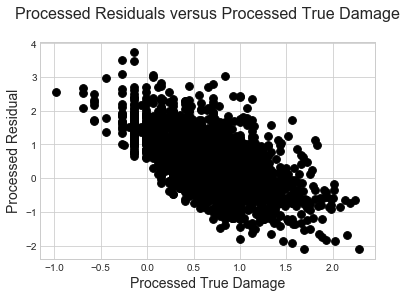

In [16]:
plt.scatter(test_set['DAMAGE_PROPERTY'],
            test_set['residual_of_log_xformed'],
            facecolor = 'k', s = 60)
plt.ylabel("Processed Residual", size = 14)
plt.xlabel("Processed True Damage", size = 14)
plt.title("Processed Residuals versus Processed True Damage\n", size = 16)

While the trend of underestimating at high values remains true in processed-scale data, it is much less severe. The trend here is actually centered on zero, with the model often overpredicting on low values.

This isn't pronounced on the previous plots because the axes are so compressed due to scale.

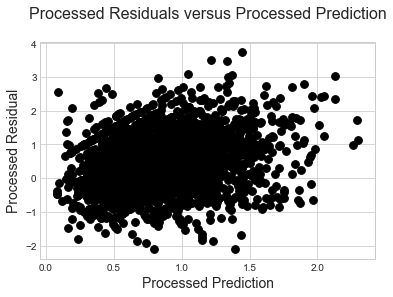

In [17]:
plt.scatter(best_model_perf['predicted_values'],
            test_set['residual_of_log_xformed'],
            facecolor = 'k', s = 60)
plt.ylabel("Processed Residual", size = 14)
plt.xlabel("Processed Prediction", size = 14)
plt.title("Processed Residuals versus Processed Prediction\n", size = 16)

And it appears that the prediction is not necessarily an over- or underestimate based solely on the value of the prediction, this is a pretty random spread.

The problem displayed by these plots is that the model is optimized using processed data (which is required for decent optimization), and this processed optimization does not optimize well in respect to the extremely damaging events, because it optimizes with respect to magnitude, treating all magnitude differences equally; when in reality, being wrong in the magnitude from 1 to 100 is much less important than being wrong in the magnitude from 10,000 to 1,000,000.

### Import the predictions grid

In [18]:
predictions_2018 = pd.read_csv("C:\\Users\\Jeremy Diaz\\Documents\\earth-analytics\\tornadoesr\\Complete_Workflow\\grid_with_predictions_oversamp.csv")

Making the month variable easier to work with.

In [19]:
predictions_2018['MONTH'] = pd.factorize(predictions_2018.MONTH)[0] + 1

Undoing the processing.

In [20]:
predictions_2018['DAMAGE_PROPERTY'] = np.exp((predictions_2018['DAMAGE_PROPERTY'] * stand_dev_log_dam) + mean_log_dam) - 1

predictions_2018['log_10_dam'] = np.log10(predictions_2018['DAMAGE_PROPERTY'] + 1)

predictions_2018['BEGIN_LAT'] = (predictions_2018['BEGIN_LAT'] * stand_dev_lat) + mean_lat

predictions_2018['BEGIN_LON'] = (predictions_2018['BEGIN_LON'] * stand_dev_lon) + mean_lon

Getting the labels.

In [21]:
labels2 = []

for i in range(len(predictions_2018['DAMAGE_PROPERTY'])):
    
    intermediate = locale.format("%d", predictions_2018["DAMAGE_PROPERTY"][i], grouping = True)
    
    intermediate = "$" + intermediate
    
    labels2.append(intermediate)
    
predictions_2018['labels'] = labels2

Separating months so that the map can have a dropdown menu selection.

In [22]:
jan_data = predictions_2018[predictions_2018['MONTH'] == 1]
feb_data = predictions_2018[predictions_2018['MONTH'] == 2]
mar_data = predictions_2018[predictions_2018['MONTH'] == 3]
apr_data = predictions_2018[predictions_2018['MONTH'] == 4]
may_data = predictions_2018[predictions_2018['MONTH'] == 5]
jun_data = predictions_2018[predictions_2018['MONTH'] == 6]
jul_data = predictions_2018[predictions_2018['MONTH'] == 7]
aug_data = predictions_2018[predictions_2018['MONTH'] == 8]
sep_data = predictions_2018[predictions_2018['MONTH'] == 9]
oct_data = predictions_2018[predictions_2018['MONTH'] == 10]
nov_data = predictions_2018[predictions_2018['MONTH'] == 11]
dec_data = predictions_2018[predictions_2018['MONTH'] == 12]

# The 2018 Prediction Map

The map color legend will appear very messy until you select a dropdown button, after which it will be clear. The color legend adjusts *slightly* with each month due to differences in maximum and minimum predictions.

In [23]:
# Each trace can be thought of as a layer to the map
# trace1-12 are monthly data points
trace1 = {"lon": jan_data["BEGIN_LON"],
          "lat":  jan_data["BEGIN_LAT"],
          "name": "Prediction",
          "text": jan_data["labels"],
          "marker": {"color": jan_data["log_10_dam"],
                     "colorscale": "Viridis",
                     "size": 2.5,
                     "symbol":"square",
                     "cmin": predictions_2018['log_10_dam'].min(),
                     "cmax": predictions_2018['log_10_dam'].min(),
                     "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
          "type": "scattergeo", 
          "visible": True}
trace2 = {"lon": feb_data["BEGIN_LON"],
          "lat":  feb_data["BEGIN_LAT"], 
          "name": "Prediction",
          "text": feb_data["labels"],
          "marker": {"color": feb_data["log_10_dam"],
                     "colorscale": "Viridis",
                     "size": 2.5,
                     "symbol":"square",
                     "cmin": predictions_2018['log_10_dam'].min(),
                     "cmax": predictions_2018['log_10_dam'].min(),
                     "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
          "type": "scattergeo", 
          "visible": True}
trace3 = {"lon": mar_data["BEGIN_LON"],
          "lat":  mar_data["BEGIN_LAT"],
          "name": "Prediction",
          "text": mar_data["labels"],
          "marker": {"color": mar_data["log_10_dam"],
                     "colorscale": "Viridis",
                     "size": 2.5,
                     "symbol":"square",
                     "cmin": predictions_2018['log_10_dam'].min(),
                     "cmax": predictions_2018['log_10_dam'].min(),
                     "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
          "type": "scattergeo", 
          "visible": True}
trace4 = {"lon": apr_data["BEGIN_LON"],
          "lat":  apr_data["BEGIN_LAT"],
          "name": "Prediction",
          "text": apr_data["labels"],
          "marker": {"color": apr_data["log_10_dam"],
                     "colorscale": "Viridis",
                     "size": 2.5,
                     "symbol":"square",
                     "cmin": predictions_2018['log_10_dam'].min(),
                     "cmax": predictions_2018['log_10_dam'].min(),
                     "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
          "type": "scattergeo", 
          "visible": True}
trace5 = {"lon": may_data["BEGIN_LON"],
          "lat":  may_data["BEGIN_LAT"],
          "name": "Prediction",
          "text": may_data["labels"],
          "marker": {"color": may_data["log_10_dam"],
                     "colorscale": "Viridis",
                     "size": 2.5,
                     "symbol":"square",
                     "cmin": predictions_2018['log_10_dam'].min(),
                     "cmax": predictions_2018['log_10_dam'].min(),
                     "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
          "type": "scattergeo", 
          "visible": True}
trace6 = {"lon": jun_data["BEGIN_LON"],
          "lat":  jun_data["BEGIN_LAT"],
          "name": "Prediction",
          "text": jun_data["labels"],
          "marker": {"color": jun_data["log_10_dam"],
                     "colorscale": "Viridis",
                     "size": 2.5,
                     "symbol":"square",
                     "cmin": predictions_2018['log_10_dam'].min(),
                     "cmax": predictions_2018['log_10_dam'].min(),
                     "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
          "type": "scattergeo", 
          "visible": True}
trace7 = {"lon": jul_data["BEGIN_LON"],
          "lat":  jul_data["BEGIN_LAT"],
          "name": "Prediction",
          "text": jul_data["labels"],
          "marker": {"color": jul_data["log_10_dam"],
                     "colorscale": "Viridis",
                     "size": 2.5,
                     "symbol":"square",
                     "cmin": predictions_2018['log_10_dam'].min(),
                     "cmax": predictions_2018['log_10_dam'].min(),
                     "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
          "type": "scattergeo", 
          "visible": True}
trace8 = {"lon": aug_data["BEGIN_LON"],
          "lat":  aug_data["BEGIN_LAT"],
          "name": "Prediction",
          "text": aug_data["labels"], 
          "marker": {"color": aug_data["log_10_dam"],
                     "colorscale": "Viridis",
                     "size": 2.5,
                     "symbol":"square",
                     "cmin": predictions_2018['log_10_dam'].min(),
                     "cmax": predictions_2018['log_10_dam'].min(),
                     "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
          "type": "scattergeo", 
          "visible": True}
trace9 = {"lon": sep_data["BEGIN_LON"],
          "lat":  sep_data["BEGIN_LAT"],
          "name": "Prediction",
          "text": sep_data["labels"],
          "marker": {"color": sep_data["log_10_dam"],
                     "colorscale": "Viridis",
                     "size": 2.5,
                     "symbol":"square",
                     "cmin": predictions_2018['log_10_dam'].min(),
                     "cmax": predictions_2018['log_10_dam'].min(),
                     "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
          "type": "scattergeo", 
          "visible": True}
trace10 = {"lon": oct_data["BEGIN_LON"],
           "lat":  oct_data["BEGIN_LAT"],
           "name": "Prediction",
           "text": oct_data["labels"],
           "marker": {"color": oct_data["log_10_dam"],
                      "colorscale": "Viridis",
                      "size": 2.5,
                      "symbol":"square",
                      "cmin": predictions_2018['log_10_dam'].min(),
                      "cmax": predictions_2018['log_10_dam'].min(),
                      "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
           "type": "scattergeo", 
           "visible": True}
trace11 = {"lon": nov_data["BEGIN_LON"],
           "lat":  nov_data["BEGIN_LAT"],
           "name": "Prediction",
           "text": nov_data["labels"],
           "marker": {"color": nov_data["log_10_dam"],
                      "colorscale": "Viridis",
                      "size": 2.5,
                      "symbol":"square",
                      "cmin": predictions_2018['log_10_dam'].min(),
                      "cmax": predictions_2018['log_10_dam'].min(),
                      "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
           "type": "scattergeo", 
           "visible": True}
trace12 = {"lon": dec_data["BEGIN_LON"],
           "lat":  dec_data["BEGIN_LAT"],
           "name": "Prediction",
           "text": dec_data["labels"],
           "marker": {"color": dec_data["log_10_dam"],
                      "colorscale": "Viridis",
                      "size": 2.5,
                      "symbol":"square",
                      "cmin": predictions_2018['log_10_dam'].min(),
                      "cmax": predictions_2018['log_10_dam'].min(),
                      "colorbar": dict(title = 'Magnitude of Predicted<br>Property Damage')},
           "type": "scattergeo", 
           "visible": True}


# trace13-24 are identical and are the cities
# They are repeated so that they can be redrawn for each dropdown selection
# Otherwise they become background to the prediction points
# And therefore less visible
trace13 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace14 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace15 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace16 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace17 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace18 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace19 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace20 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace21 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace22 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace23 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}
trace24 = {"lon": cities_df["lon"],
           "lat":  cities_df["lat"],
           "name": "City",
           "text": city_labels,
           "marker": {"size": 4,
                      "symbol": "star-open",
                      "color": "beige"},
           "type": "scattergeo"}


# Acknowledge all the traces as a the map data
data2 = Data([trace1, trace2, trace3, trace4,
              trace5, trace6, trace7, trace8,
              trace9, trace10, trace11, trace12,
              trace13, trace14, trace15, trace16,
              trace17, trace18, trace19, trace20,
              trace21, trace22, trace23, trace24])


# Design the layout/background
layout2 = dict(geo = dict(scope = 'north america',
                          showland = True,
                          landcolor = "rgb(0, 0, 0)",
                          subunitcolor = "rgb(255, 255, 255)",
                          countrycolor = "rgb(255, 255, 255)",
                          showlakes = True,
                          showocean = True,
                          lakecolor = "rgb(23, 23, 23)",
                          oceancolor = "rgb(23, 23, 23)",
                          showsubunits = True,
                          showcountries = True,
                          resolution = 50,
                          lonaxis = dict(showgrid = True,
                                         gridwidth = 0.05,
                                         range= [-125.0, -70.0],
                                         dtick = 5),
                          lataxis = dict(showgrid = True,
                                         gridwidth = 0.05,
                                         range= [23.0, 50.0],
                                         dtick = 5)),
               title = 'Model Predictions for 2018',
               showlegend = False)


# Set up the dropdown selections
updatemenus = [{'buttons': [{'args': ['visible', [True, False, False, False,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  True, False, False, False,
                                                  False, False, False, False,
                                                  False, False, False, False]],
                             'label': 'Show January',
                             'method': 'restyle'},
                            {'args': ['visible', [False, True, False, False,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  False, True, False, False,
                                                  False, False, False, False,
                                                  False, False, False, False]],
                             'label': 'Show February',
                             'method': 'restyle'},
                            {'args': ['visible', [False, False, True, False,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  False, False, True, False,
                                                  False, False, False, False,
                                                  False, False, False, False]],
                             'label': "Show March",
                             'method': 'restyle'},
                            {'args': ['visible', [False, False, False, True,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  False, False, False, True,
                                                  False, False, False, False,
                                                  False, False, False, False]],
                             'label': "Show April",
                             'method': 'restyle'},
                            {'args': ['visible', [False, False, False, False,
                                                  True, False, False, False,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  True, False, False, False,
                                                  False, False, False, False]],
                             'label': "Show May",
                             'method': 'restyle'},
                            {'args': ['visible', [False, False, False, False,
                                                  False, True, False, False,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  False, True, False, False,
                                                  False, False, False, False]],
                             'label': "Show June",
                             'method': 'restyle'},
                            {'args': ['visible', [False, False, False, False,
                                                  False, False, True, False,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  False, False, True, False,
                                                  False, False, False, False]],
                             'label': "Show July",
                             'method': 'restyle'},
                            {'args': ['visible', [False, False, False, False,
                                                  False, False, False, True,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  False, False, False, True,
                                                  False, False, False, False]],
                             'label': "Show August",
                             'method': 'restyle'},
                            {'args': ['visible', [False, False, False, False,
                                                  False, False, False, False,
                                                  True, False, False, False,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  True, False, False, False]],
                             'label': "Show September",
                             'method': 'restyle'},
                            {'args': ['visible', [False, False, False, False,
                                                  False, False, False, False,
                                                  False, True, False, False,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  False, True, False, False]],
                             'label': "Show October",
                             'method': 'restyle'},
                            {'args': ['visible', [False, False, False, False,
                                                  False, False, False, False,
                                                  False, False, True, False,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  False, False, True, False]],
                             'label': "Show November",
                             'method': 'restyle'},
                            {'args': ['visible', [False, False, False, False,
                                                  False, False, False, False,
                                                  False, False, False, True,
                                                  False, False, False, False,
                                                  False, False, False, False,
                                                  False, False, False, True]],
                             'label': "Show December",
                             'method': 'restyle'}],
               'type': 'buttons'}]


# Add those dropdown selections to the layout information
layout2['updatemenus'] = updatemenus


# Make the figure
fig2 = {'data':data2,
       'layout':layout2}


# Plot the figure
plotly.offline.iplot(fig2)